In [1]:
import numpy as np
import pandas as pd
import librosa
import librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd

Samplerate is 48 kHz and bitrate 24 bit

In [2]:
SampleRate = 480000 #Hz

In [3]:
#Sustain Note
Sus_Clean, _ = librosa.load(f'data\SustainNote_Clean.wav',sr = SampleRate)
Sus_Distored, _ = librosa.load(f'data\SustainNote_Distorted.wav',sr = SampleRate)

#Chromatic
Chr_Clean, _ = librosa.load(f'data\Chromatic_Clean.wav',sr = SampleRate)
Chr_Distored, _ = librosa.load(f'data\Chromatic_Distorted.wav',sr = SampleRate)

#Major Chord
Maj_Clean, _ = librosa.load(f'data\MajorChord_Clean.wav',sr = SampleRate)
Maj_Distored, _ = librosa.load(f'data\MajorChord_Distorted.wav',sr = SampleRate)

#Minor Chord
Min_Clean, _ = librosa.load(f'data\MinorChord_Clean.wav',sr = SampleRate)
Min_Distored, _ = librosa.load(f'data\MinorChord_Distorted.wav',sr = SampleRate)

#Power Chord
Pow_Clean, _ = librosa.load(f'data\PowerChord_Clean.wav',sr = SampleRate)
Pow_Distored, _ = librosa.load(f'data\PowerChord_Distorted.wav',sr = SampleRate)

#Random
Ran_Clean, _ = librosa.load(f'data\Random_Clean.wav',sr = SampleRate)
Ran_Distored, _ = librosa.load(f'data\Random_Distorted.wav',sr = SampleRate)

#Solo
Solo_Clean, _ = librosa.load(f'data\Solo_Clean.wav',sr = SampleRate)
Solo_Distored, _ = librosa.load(f'data\Solo_Distorted.wav',sr = SampleRate)


In [4]:
# Sustain Note
print('Sustain Note :', len(Sus_Clean) / SampleRate, 'seconds')

# Chromatic
print('Chromatic :', len(Chr_Clean) / SampleRate, 'seconds')

# Major Chord
print('Major Chord :', len(Maj_Clean) / SampleRate, 'seconds')

# Minor Chord
print('Minor Chord :', len(Min_Clean) / SampleRate, 'seconds')

# Power Chord
print('Power Chord :', len(Pow_Clean) / SampleRate, 'seconds')

# Random
print('Random :', len(Ran_Clean) / SampleRate, 'seconds')

Sustain Note : 287.2426875 seconds
Chromatic : 14.016 seconds
Major Chord : 16.7786875 seconds
Minor Chord : 17.1306875 seconds
Power Chord : 70.336 seconds
Random : 32.5546875 seconds


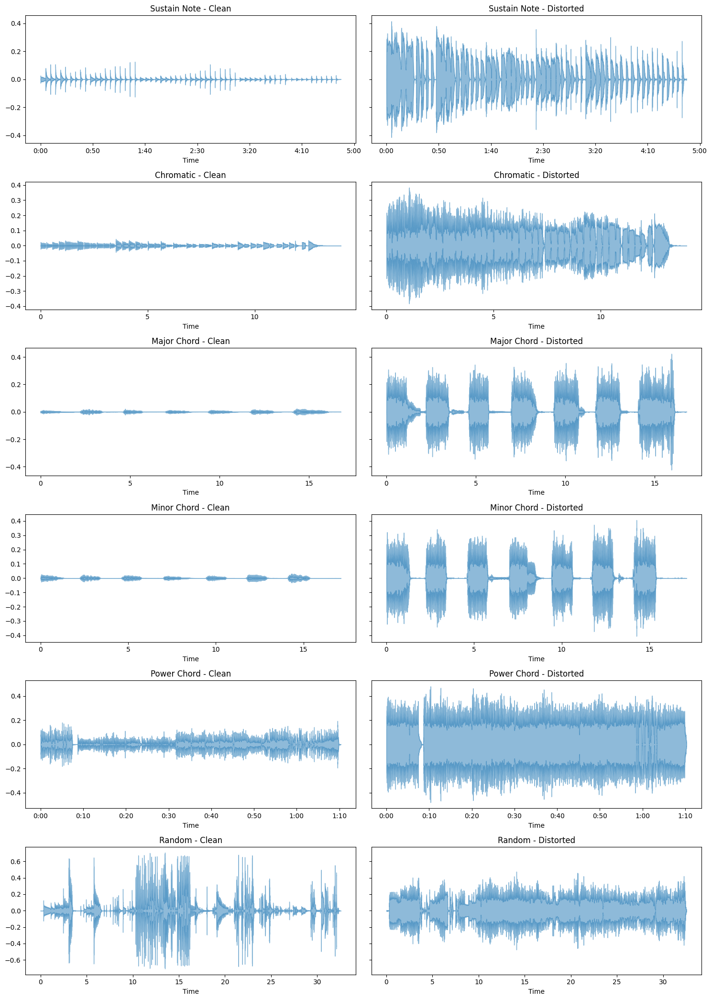

In [5]:
# Create subplots manually
fig, axs = plt.subplots(6, 2, figsize=(15, 21),sharey='row')

# Sustain Note
librosa.display.waveshow(Sus_Clean, sr=SampleRate, alpha=0.5, ax=axs[0, 0])
axs[0, 0].set_title('Sustain Note - Clean')

librosa.display.waveshow(Sus_Distored, sr=SampleRate, alpha=0.5, ax=axs[0, 1])
axs[0, 1].set_title('Sustain Note - Distorted')

# Chromatic
librosa.display.waveshow(Chr_Clean, sr=SampleRate, alpha=0.5, ax=axs[1, 0])
axs[1, 0].set_title('Chromatic - Clean')

librosa.display.waveshow(Chr_Distored, sr=SampleRate, alpha=0.5, ax=axs[1, 1])
axs[1, 1].set_title('Chromatic - Distorted')

# Major Chord
librosa.display.waveshow(Maj_Clean, sr=SampleRate, alpha=0.5, ax=axs[2, 0])
axs[2, 0].set_title('Major Chord - Clean')

librosa.display.waveshow(Maj_Distored, sr=SampleRate, alpha=0.5, ax=axs[2, 1])
axs[2, 1].set_title('Major Chord - Distorted')

# Minor Chord
librosa.display.waveshow(Min_Clean, sr=SampleRate, alpha=0.5, ax=axs[3, 0])
axs[3, 0].set_title('Minor Chord - Clean')

librosa.display.waveshow(Min_Distored, sr=SampleRate, alpha=0.5, ax=axs[3, 1])
axs[3, 1].set_title('Minor Chord - Distorted')

# Power Chord
librosa.display.waveshow(Pow_Clean, sr=SampleRate, alpha=0.5, ax=axs[4, 0])
axs[4, 0].set_title('Power Chord - Clean')

librosa.display.waveshow(Pow_Distored, sr=SampleRate, alpha=0.5, ax=axs[4, 1])
axs[4, 1].set_title('Power Chord - Distorted')

# Random
librosa.display.waveshow(Ran_Clean, sr=SampleRate, alpha=0.5, ax=axs[5, 0])
axs[5, 0].set_title('Random - Clean')

librosa.display.waveshow(Ran_Distored, sr=SampleRate, alpha=0.5, ax=axs[5, 1])
axs[5, 1].set_title('Random - Distorted')

# Adjust layout and show plot
plt.tight_layout()
plt.show()

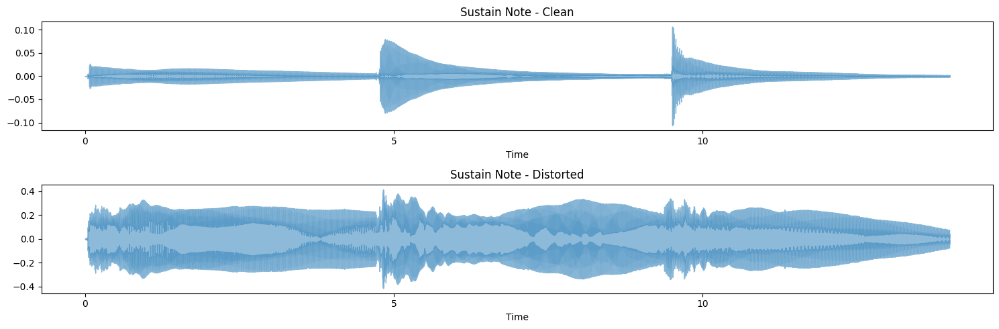

In [8]:
plt.figure(figsize=(15, 5))

# Plot the clean waveform
plt.subplot(2, 1, 1)
librosa.display.waveshow(Sus_Clean[:int(14*SampleRate)], sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Clean')
plt.xlabel('Time')

# Plot the actual and predicted waveforms in the same subplot
plt.subplot(2, 1, 2)
librosa.display.waveshow(Sus_Distored[:int(14*SampleRate)],sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Distorted')
plt.xlabel('Time')

plt.tight_layout()
plt.show()

In [190]:
ipd.Audio(data=Sus_Clean[int(9.5*SampleRate):int(14*SampleRate)], rate=SampleRate)

In [191]:
ipd.Audio(data=Sus_Distored[int(9.5*SampleRate):int(14*SampleRate)], rate=SampleRate)

In [67]:
def frequency_to_note(frequency):
    A4_frequency = 440  # Reference frequency for A4 note
    note_number = 12 * np.log2(frequency / A4_frequency) + 69
    rounded_note = round(note_number)
    octave = int((rounded_note + 3) // 12)  # Adjusting for note A0 being 1 instead of 0
    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    note_name = note_names[int(rounded_note % 12)]
    return f"{note_name}{octave}"

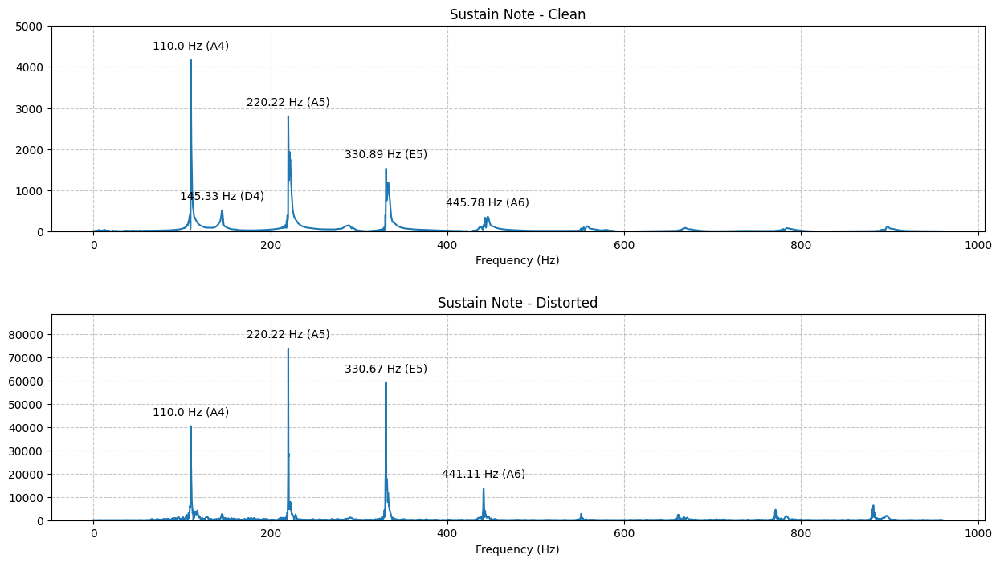

In [192]:
# Function to label the top frequencies
f_ratio = 0.002
# Function to label the top frequencies
from scipy.signal import find_peaks
## Function to label the top frequencies (spikes)
# Function to calculate note names and octaves for a given frequency
def frequency_to_note(frequency):
    A4_frequency = 440  # Reference frequency for A4 note
    note_number = 12 * np.log2(frequency / A4_frequency) + 69
    rounded_note = round(note_number)
    octave = int((rounded_note + 3) // 12)  # Adjusting for note A0 being 1 instead of 0
    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    note_name = note_names[int(rounded_note % 12)]
    return f"{note_name}{octave}"

# Function to find peaks and label spikes
def label_spikes(ax, f, X_mag, f_bins, threshold=0.5, top_n=12):
    # Find peaks using scipy's find_peaks function
    peaks, _ = find_peaks(X_mag, height=threshold)

    # Sort peaks by magnitude
    sorted_peaks = peaks[np.argsort(X_mag[peaks])][::-1]

    # Label the top peaks
    peak = []
    for i in range(min(top_n, len(sorted_peaks))):
        peak_index = sorted_peaks[i]
        peak.append([np.round(f[peak_index], decimals=2),frequency_to_note(f[peak_index]),np.round(X_mag[peak_index], decimals=2)])
    
    peak = np.array(peak)

    
    filter_data = []
    Note = []
    for sdata in peak:
        if sdata[1] not in Note:
            filter_data.append(sdata)
            Note.append(sdata[1])

    # Now you can use the data for plotting
    for fq , note , mag in filter_data:
        ax.annotate(f"{fq} Hz ({note})", 
                    (float(fq), float(mag)), textcoords="offset points", xytext=(0, 10), ha='center')
# Plot for Sus_Clean
signal_clean = Sus_Clean[int(9.5*SampleRate):int(14*SampleRate)]
X_clean = np.fft.fft(signal_clean)
X_mag_clean = np.abs(X_clean)

# Calculate frequencies using np.fft.fftfreq
n_clean = len(X_mag_clean)
f_clean = np.fft.fftfreq(n_clean, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_clean = int(n_clean * f_ratio)

# Create subplots with more space between them
fig, axes = plt.subplots(2, 1, figsize=(15, 8))
fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

axes[0].plot(f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean])
axes[0].set(xlabel='Frequency (Hz)', title="Sustain Note - Clean")
axes[0].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[0], f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean], f_bins_clean)

# Adjust the y-axis limit to increase space at the top
axes[0].set_ylim(0, 1.2 * np.max(X_mag_clean[:f_bins_clean]))

# Plot for Sus_distorted
signal_distorted = Sus_Distored[int(9.5*SampleRate):int(14*SampleRate)]
X_distorted = np.fft.fft(signal_distorted)
X_mag_distorted = np.abs(X_distorted)

# Calculate frequencies using np.fft.fftfreq
n_distorted = len(X_mag_distorted)
f_distorted = np.fft.fftfreq(n_distorted, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_distorted = int(n_distorted * f_ratio)

axes[1].plot(f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted])
axes[1].set(xlabel='Frequency (Hz)', title="Sustain Note - Distorted")
axes[1].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[1], f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted], f_bins_distorted)

# Adjust the y-axis limit to increase space at the top
axes[1].set_ylim(0, 1.2 * np.max(X_mag_distorted[:f_bins_distorted]))

plt.show()

In [ ]:
ipd.Audio(data=Sus_Clean[:int(4.7*SampleRate)], rate=SampleRate)

In [ ]:
ipd.Audio(data=Sus_Distored[:int(4.7*SampleRate)], rate=SampleRate)

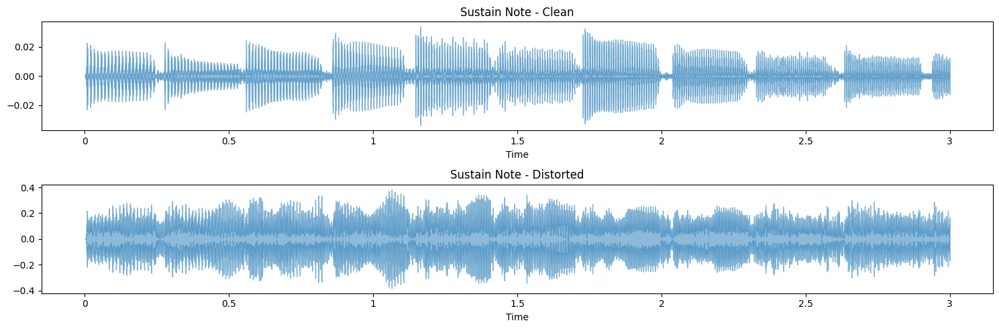

In [155]:
plt.figure(figsize=(15, 5))

# Plot the clean waveform
plt.subplot(2, 1, 1)
librosa.display.waveshow(Chr_Clean[:int(3*SampleRate)], sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Clean')
plt.xlabel('Time')

# Plot the actual and predicted waveforms in the same subplot
plt.subplot(2, 1, 2)
librosa.display.waveshow(Chr_Distored[:int(3*SampleRate)],sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Distorted')
plt.xlabel('Time')

plt.tight_layout()
plt.show()

In [203]:
ipd.Audio(data=Chr_Distored[int(1.1*SampleRate):int(1.45*SampleRate)], rate=SampleRate)

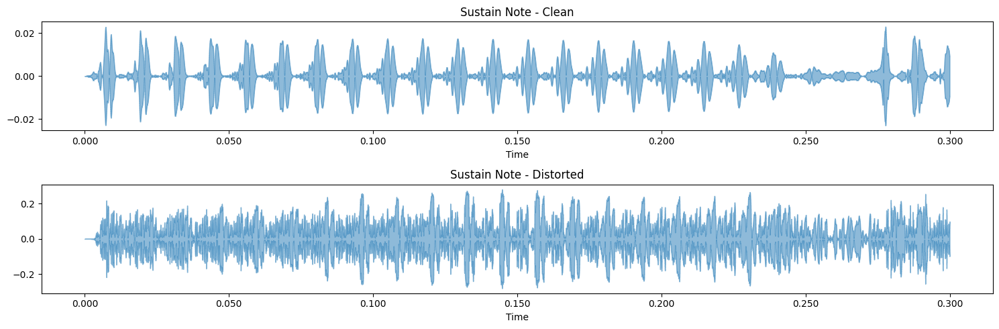

In [160]:
plt.figure(figsize=(15, 5))

# Plot the clean waveform
plt.subplot(2, 1, 1)
librosa.display.waveshow(Chr_Clean[:int(0.3*SampleRate)], sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Clean')
plt.xlabel('Time')

# Plot the actual and predicted waveforms in the same subplot
plt.subplot(2, 1, 2)
librosa.display.waveshow(Chr_Distored[:int(0.3*SampleRate)],sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Distorted')
plt.xlabel('Time')

plt.tight_layout()
plt.show()

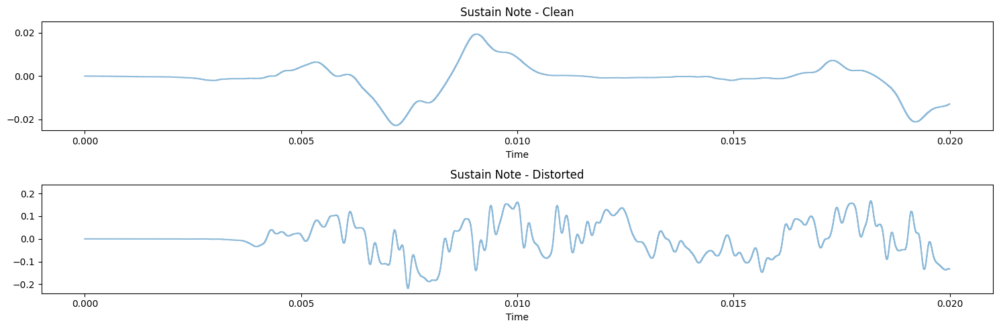

In [157]:
plt.figure(figsize=(15, 5))

# Plot the clean waveform
plt.subplot(2, 1, 1)
librosa.display.waveshow(Chr_Clean[:int(0.02*SampleRate)], sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Clean')
plt.xlabel('Time')

# Plot the actual and predicted waveforms in the same subplot
plt.subplot(2, 1, 2)
librosa.display.waveshow(Chr_Distored[:int(0.02*SampleRate)],sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Distorted')
plt.xlabel('Time')

plt.tight_layout()
plt.show()

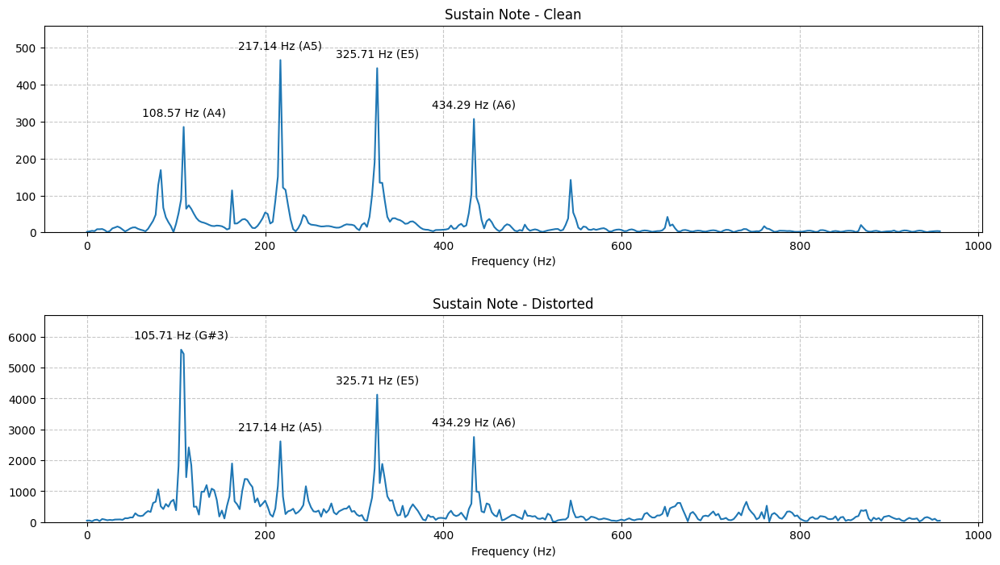

In [205]:
# Function to label the top frequencies
f_ratio = 0.002
# Function to label the top frequencies
from scipy.signal import find_peaks
## Function to label the top frequencies (spikes)
# Function to calculate note names and octaves for a given frequency
def frequency_to_note(frequency):
    A4_frequency = 440  # Reference frequency for A4 note
    note_number = 12 * np.log2(frequency / A4_frequency) + 69
    rounded_note = round(note_number)
    octave = int((rounded_note + 3) // 12)  # Adjusting for note A0 being 1 instead of 0
    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    note_name = note_names[int(rounded_note % 12)]
    return f"{note_name}{octave}"

# Function to find peaks and label spikes
def label_spikes(ax, f, X_mag, f_bins, threshold=0.5, top_n=4):
    # Find peaks using scipy's find_peaks function
    peaks, _ = find_peaks(X_mag, height=threshold)

    # Sort peaks by magnitude
    sorted_peaks = peaks[np.argsort(X_mag[peaks])][::-1]

    # Label the top peaks
    peak = []
    for i in range(min(top_n, len(sorted_peaks))):
        peak_index = sorted_peaks[i]
        peak.append([np.round(f[peak_index], decimals=2),frequency_to_note(f[peak_index]),np.round(X_mag[peak_index], decimals=2)])
    
    peak = np.array(peak)

    
    filter_data = []
    Note = []
    for sdata in peak:
        if sdata[1] not in Note:
            filter_data.append(sdata)
            Note.append(sdata[1])

    # Now you can use the data for plotting
    for fq , note , mag in filter_data:
        ax.annotate(f"{fq} Hz ({note})", 
                    (float(fq), float(mag)), textcoords="offset points", xytext=(0, 10), ha='center')
# Plot for Sus_Clean
signal_clean = Chr_Clean[int(1.1*SampleRate):int(1.45*SampleRate)]
X_clean = np.fft.fft(signal_clean)
X_mag_clean = np.abs(X_clean)

# Calculate frequencies using np.fft.fftfreq
n_clean = len(X_mag_clean)
f_clean = np.fft.fftfreq(n_clean, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_clean = int(n_clean * f_ratio)

# Create subplots with more space between them
fig, axes = plt.subplots(2, 1, figsize=(15, 8))
fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

axes[0].plot(f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean])
axes[0].set(xlabel='Frequency (Hz)', title="Sustain Note - Clean")
axes[0].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[0], f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean], f_bins_clean)

# Adjust the y-axis limit to increase space at the top
axes[0].set_ylim(0, 1.2 * np.max(X_mag_clean[:f_bins_clean]))

# Plot for Sus_distorted
signal_distorted = Chr_Distored[int(1.1*SampleRate):int(1.45*SampleRate)]
X_distorted = np.fft.fft(signal_distorted)
X_mag_distorted = np.abs(X_distorted)

# Calculate frequencies using np.fft.fftfreq
n_distorted = len(X_mag_distorted)
f_distorted = np.fft.fftfreq(n_distorted, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_distorted = int(n_distorted * f_ratio)

axes[1].plot(f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted])
axes[1].set(xlabel='Frequency (Hz)', title="Sustain Note - Distorted")
axes[1].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[1], f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted], f_bins_distorted)

# Adjust the y-axis limit to increase space at the top
axes[1].set_ylim(0, 1.2 * np.max(X_mag_distorted[:f_bins_distorted]))

plt.show()

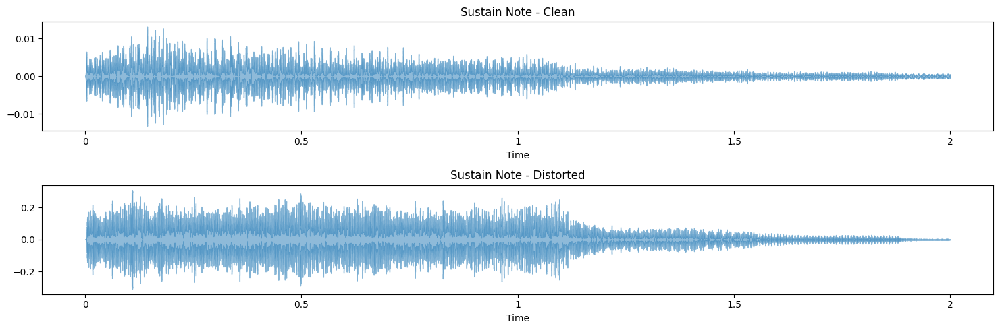

In [164]:
plt.figure(figsize=(15, 5))

# Plot the clean waveform
plt.subplot(2, 1, 1)
librosa.display.waveshow(Maj_Clean[:int(2*SampleRate)], sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Clean')
plt.xlabel('Time')

# Plot the actual and predicted waveforms in the same subplot
plt.subplot(2, 1, 2)
librosa.display.waveshow(Maj_Distored[:int(2*SampleRate)],sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Distorted')
plt.xlabel('Time')

plt.tight_layout()
plt.show()

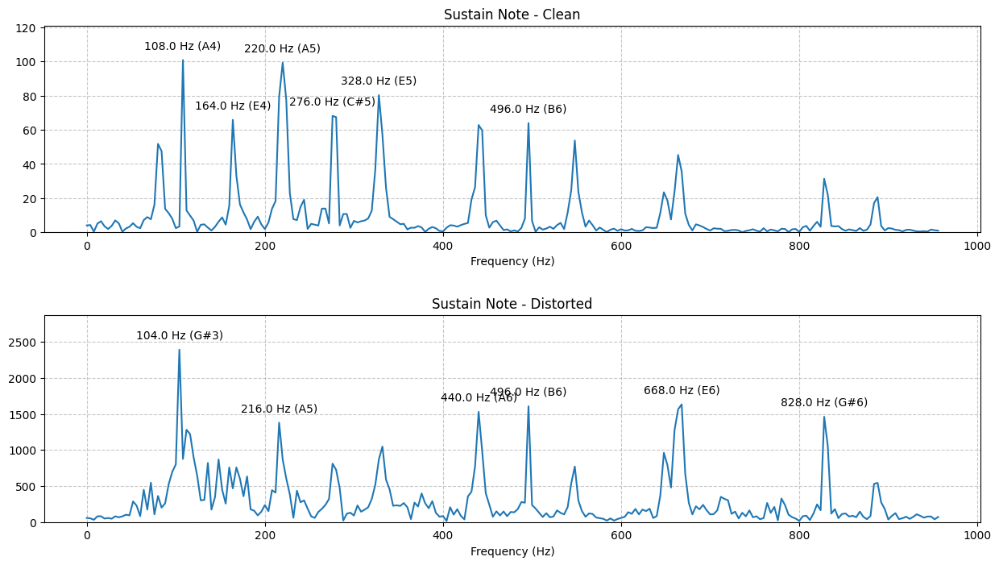

In [166]:
# Function to label the top frequencies
f_ratio = 0.002
# Function to label the top frequencies
from scipy.signal import find_peaks
## Function to label the top frequencies (spikes)
# Function to calculate note names and octaves for a given frequency
def frequency_to_note(frequency):
    A4_frequency = 440  # Reference frequency for A4 note
    note_number = 12 * np.log2(frequency / A4_frequency) + 69
    rounded_note = round(note_number)
    octave = int((rounded_note + 3) // 12)  # Adjusting for note A0 being 1 instead of 0
    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    note_name = note_names[int(rounded_note % 12)]
    return f"{note_name}{octave}"

# Function to find peaks and label spikes
def label_spikes(ax, f, X_mag, f_bins, threshold=0.5, top_n=6):
    # Find peaks using scipy's find_peaks function
    peaks, _ = find_peaks(X_mag, height=threshold)

    # Sort peaks by magnitude
    sorted_peaks = peaks[np.argsort(X_mag[peaks])][::-1]

    # Label the top peaks
    peak = []
    for i in range(min(top_n, len(sorted_peaks))):
        peak_index = sorted_peaks[i]
        peak.append([np.round(f[peak_index], decimals=2),frequency_to_note(f[peak_index]),np.round(X_mag[peak_index], decimals=2)])
    
    peak = np.array(peak)

    
    filter_data = []
    Note = []
    for sdata in peak:
        if sdata[1] not in Note:
            filter_data.append(sdata)
            Note.append(sdata[1])

    # Now you can use the data for plotting
    for fq , note , mag in filter_data:
        ax.annotate(f"{fq} Hz ({note})", 
                    (float(fq), float(mag)), textcoords="offset points", xytext=(0, 10), ha='center')
# Plot for Sus_Clean
signal_clean = Maj_Clean[:int(0.25 * SampleRate)]
X_clean = np.fft.fft(signal_clean)
X_mag_clean = np.abs(X_clean)

# Calculate frequencies using np.fft.fftfreq
n_clean = len(X_mag_clean)
f_clean = np.fft.fftfreq(n_clean, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_clean = int(n_clean * f_ratio)

# Create subplots with more space between them
fig, axes = plt.subplots(2, 1, figsize=(15, 8))
fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

axes[0].plot(f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean])
axes[0].set(xlabel='Frequency (Hz)', title="Sustain Note - Clean")
axes[0].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[0], f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean], f_bins_clean)

# Adjust the y-axis limit to increase space at the top
axes[0].set_ylim(0, 1.2 * np.max(X_mag_clean[:f_bins_clean]))

# Plot for Sus_distorted
signal_distorted = Maj_Distored[:int(0.25 * SampleRate)]
X_distorted = np.fft.fft(signal_distorted)
X_mag_distorted = np.abs(X_distorted)

# Calculate frequencies using np.fft.fftfreq
n_distorted = len(X_mag_distorted)
f_distorted = np.fft.fftfreq(n_distorted, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_distorted = int(n_distorted * f_ratio)

axes[1].plot(f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted])
axes[1].set(xlabel='Frequency (Hz)', title="Sustain Note - Distorted")
axes[1].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[1], f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted], f_bins_distorted)

# Adjust the y-axis limit to increase space at the top
axes[1].set_ylim(0, 1.2 * np.max(X_mag_distorted[:f_bins_distorted]))

plt.show()

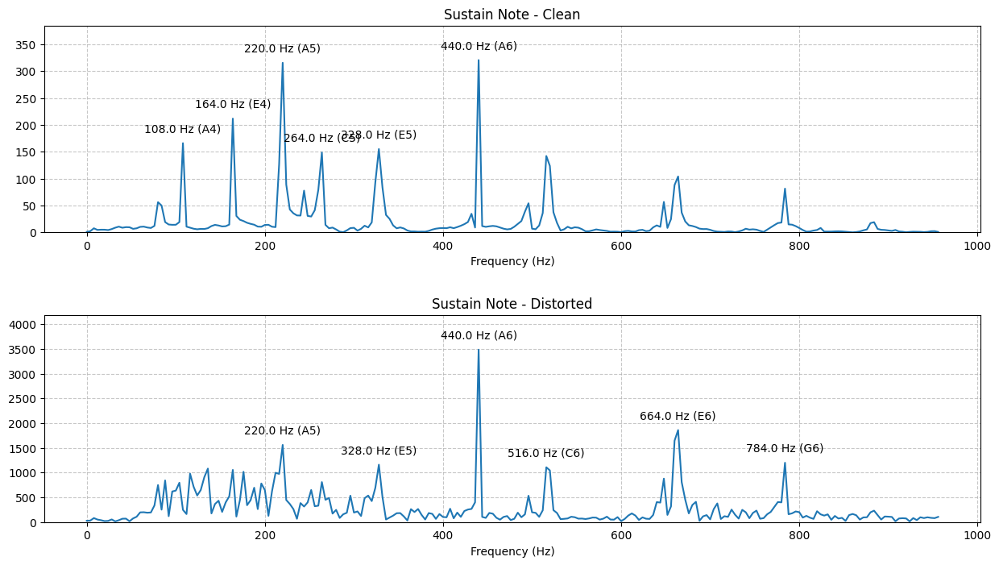

In [167]:
# Function to label the top frequencies
f_ratio = 0.002
# Function to label the top frequencies
from scipy.signal import find_peaks
## Function to label the top frequencies (spikes)
# Function to calculate note names and octaves for a given frequency
def frequency_to_note(frequency):
    A4_frequency = 440  # Reference frequency for A4 note
    note_number = 12 * np.log2(frequency / A4_frequency) + 69
    rounded_note = round(note_number)
    octave = int((rounded_note + 3) // 12)  # Adjusting for note A0 being 1 instead of 0
    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    note_name = note_names[int(rounded_note % 12)]
    return f"{note_name}{octave}"

# Function to find peaks and label spikes
def label_spikes(ax, f, X_mag, f_bins, threshold=0.5, top_n=6):
    # Find peaks using scipy's find_peaks function
    peaks, _ = find_peaks(X_mag, height=threshold)

    # Sort peaks by magnitude
    sorted_peaks = peaks[np.argsort(X_mag[peaks])][::-1]

    # Label the top peaks
    peak = []
    for i in range(min(top_n, len(sorted_peaks))):
        peak_index = sorted_peaks[i]
        peak.append([np.round(f[peak_index], decimals=2),frequency_to_note(f[peak_index]),np.round(X_mag[peak_index], decimals=2)])
    
    peak = np.array(peak)

    
    filter_data = []
    Note = []
    for sdata in peak:
        if sdata[1] not in Note:
            filter_data.append(sdata)
            Note.append(sdata[1])

    # Now you can use the data for plotting
    for fq , note , mag in filter_data:
        ax.annotate(f"{fq} Hz ({note})", 
                    (float(fq), float(mag)), textcoords="offset points", xytext=(0, 10), ha='center')
# Plot for Sus_Clean
signal_clean = Min_Clean[:int(0.25 * SampleRate)]
X_clean = np.fft.fft(signal_clean)
X_mag_clean = np.abs(X_clean)

# Calculate frequencies using np.fft.fftfreq
n_clean = len(X_mag_clean)
f_clean = np.fft.fftfreq(n_clean, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_clean = int(n_clean * f_ratio)

# Create subplots with more space between them
fig, axes = plt.subplots(2, 1, figsize=(15, 8))
fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

axes[0].plot(f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean])
axes[0].set(xlabel='Frequency (Hz)', title="Sustain Note - Clean")
axes[0].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[0], f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean], f_bins_clean)

# Adjust the y-axis limit to increase space at the top
axes[0].set_ylim(0, 1.2 * np.max(X_mag_clean[:f_bins_clean]))

# Plot for Sus_distorted
signal_distorted = Min_Distored[:int(0.25 * SampleRate)]
X_distorted = np.fft.fft(signal_distorted)
X_mag_distorted = np.abs(X_distorted)

# Calculate frequencies using np.fft.fftfreq
n_distorted = len(X_mag_distorted)
f_distorted = np.fft.fftfreq(n_distorted, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_distorted = int(n_distorted * f_ratio)

axes[1].plot(f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted])
axes[1].set(xlabel='Frequency (Hz)', title="Sustain Note - Distorted")
axes[1].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[1], f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted], f_bins_distorted)

# Adjust the y-axis limit to increase space at the top
axes[1].set_ylim(0, 1.2 * np.max(X_mag_distorted[:f_bins_distorted]))

plt.show()

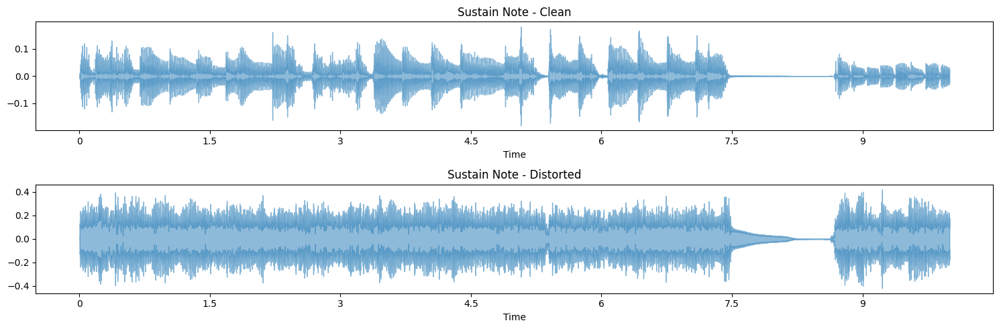

In [169]:
plt.figure(figsize=(15, 5))

# Plot the clean waveform
plt.subplot(2, 1, 1)
librosa.display.waveshow(Pow_Clean[:int(10*SampleRate)], sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Clean')
plt.xlabel('Time')

# Plot the actual and predicted waveforms in the same subplot
plt.subplot(2, 1, 2)
librosa.display.waveshow(Pow_Distored[:int(10*SampleRate)],sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Distorted')
plt.xlabel('Time')

plt.tight_layout()
plt.show()

In [176]:
ipd.Audio(data=Pow_Clean[int(8*SampleRate):int(11*SampleRate)], rate=SampleRate)

In [175]:
ipd.Audio(data=Pow_Distored[int(8*SampleRate):int(11*SampleRate)], rate=SampleRate)

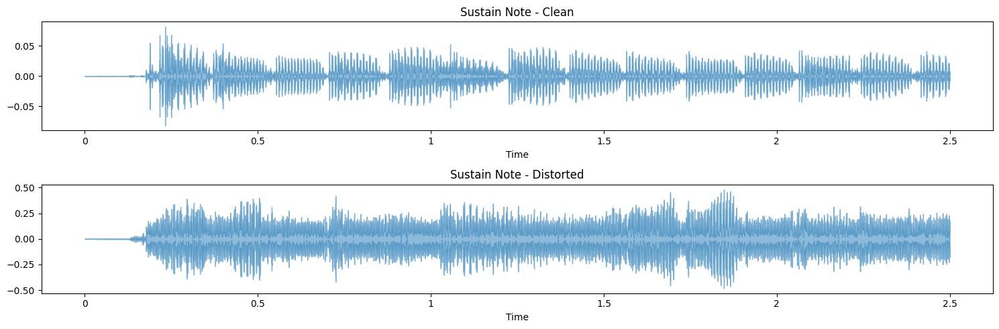

In [178]:
plt.figure(figsize=(15, 5))

# Plot the clean waveform
plt.subplot(2, 1, 1)
librosa.display.waveshow(Pow_Clean[int(8.5*SampleRate):int(11*SampleRate)], sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Clean')
plt.xlabel('Time')

# Plot the actual and predicted waveforms in the same subplot
plt.subplot(2, 1, 2)
librosa.display.waveshow(Pow_Distored[int(8.5*SampleRate):int(11*SampleRate)],sr=SampleRate,alpha=0.5)
plt.title('Sustain Note - Distorted')
plt.xlabel('Time')

plt.tight_layout()
plt.show()

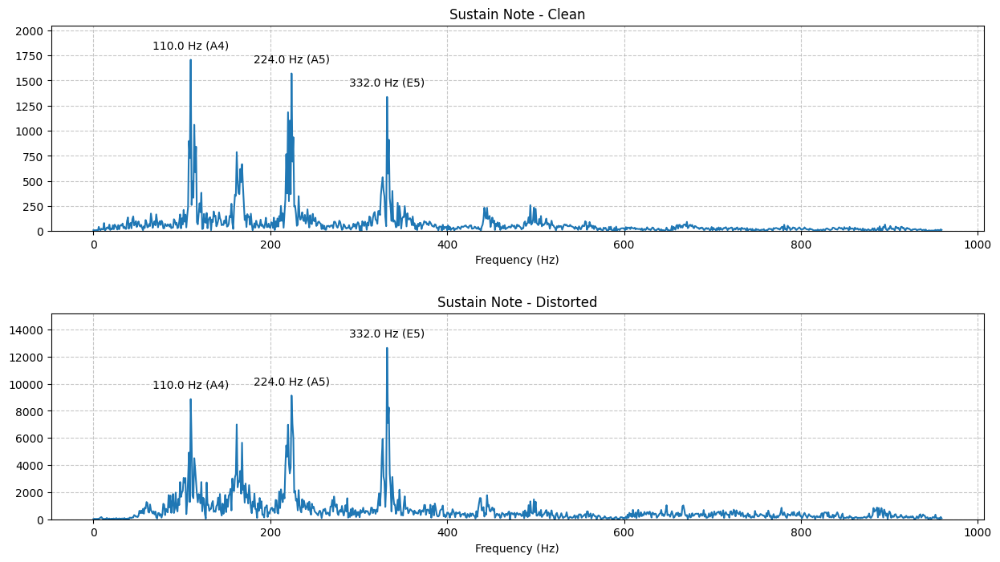

In [184]:
# Function to label the top frequencies
f_ratio = 0.002
# Function to label the top frequencies
from scipy.signal import find_peaks
## Function to label the top frequencies (spikes)
# Function to calculate note names and octaves for a given frequency
def frequency_to_note(frequency):
    A4_frequency = 440  # Reference frequency for A4 note
    note_number = 12 * np.log2(frequency / A4_frequency) + 69
    rounded_note = round(note_number)
    octave = int((rounded_note + 3) // 12)  # Adjusting for note A0 being 1 instead of 0
    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    note_name = note_names[int(rounded_note % 12)]
    return f"{note_name}{octave}"

# Function to find peaks and label spikes
def label_spikes(ax, f, X_mag, f_bins, threshold=0.5, top_n=4):
    # Find peaks using scipy's find_peaks function
    peaks, _ = find_peaks(X_mag, height=threshold)

    # Sort peaks by magnitude
    sorted_peaks = peaks[np.argsort(X_mag[peaks])][::-1]

    # Label the top peaks
    peak = []
    for i in range(min(top_n, len(sorted_peaks))):
        peak_index = sorted_peaks[i]
        peak.append([np.round(f[peak_index], decimals=2),frequency_to_note(f[peak_index]),np.round(X_mag[peak_index], decimals=2)])
    
    peak = np.array(peak)

    
    filter_data = []
    Note = []
    for sdata in peak:
        if sdata[1] not in Note:
            filter_data.append(sdata)
            Note.append(sdata[1])

    # Now you can use the data for plotting
    for fq , note , mag in filter_data:
        ax.annotate(f"{fq} Hz ({note})", 
                    (float(fq), float(mag)), textcoords="offset points", xytext=(0, 10), ha='center')
# Plot for Sus_Clean
signal_clean = Pow_Clean[int(8.5*SampleRate):int(9.5*SampleRate)]
X_clean = np.fft.fft(signal_clean)
X_mag_clean = np.abs(X_clean)

# Calculate frequencies using np.fft.fftfreq
n_clean = len(X_mag_clean)
f_clean = np.fft.fftfreq(n_clean, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_clean = int(n_clean * f_ratio)

# Create subplots with more space between them
fig, axes = plt.subplots(2, 1, figsize=(15, 8))
fig.subplots_adjust(hspace=0.4)  # Adjust the height space between subplots

axes[0].plot(f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean])
axes[0].set(xlabel='Frequency (Hz)', title="Sustain Note - Clean")
axes[0].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[0], f_clean[:f_bins_clean], X_mag_clean[:f_bins_clean], f_bins_clean)

# Adjust the y-axis limit to increase space at the top
axes[0].set_ylim(0, 1.2 * np.max(X_mag_clean[:f_bins_clean]))

# Plot for Sus_distorted
signal_distorted = Pow_Distored[int(8.5*SampleRate):int(9.5*SampleRate)]
X_distorted = np.fft.fft(signal_distorted)
X_mag_distorted = np.abs(X_distorted)

# Calculate frequencies using np.fft.fftfreq
n_distorted = len(X_mag_distorted)
f_distorted = np.fft.fftfreq(n_distorted, d=1 / SampleRate)

# Plot only positive frequencies (one-sided spectrum)
f_bins_distorted = int(n_distorted * f_ratio)

axes[1].plot(f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted])
axes[1].set(xlabel='Frequency (Hz)', title="Sustain Note - Distorted")
axes[1].grid(True, linestyle='--', alpha=0.7)
label_spikes(axes[1], f_distorted[:f_bins_distorted], X_mag_distorted[:f_bins_distorted], f_bins_distorted)

# Adjust the y-axis limit to increase space at the top
axes[1].set_ylim(0, 1.2 * np.max(X_mag_distorted[:f_bins_distorted]))

plt.show()

In [11]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

In [12]:
df = pd.DataFrame({'Distorted':Chr_Clean,'Clean':Chr_Distored})

In [13]:
df.describe()

,Distorted,Clean
count,6.727680e+06,6.727680e+06
mean,-4.417467e-07,1.117007e-06
std,6.125612e-03,7.517762e-02
min,-4.371110e-02,-3.435664e-01
25%,-1.885735e-03,-4.980798e-02
50%,6.319743e-05,-1.084466e-05
75%,2.512093e-03,5.059684e-02
max,3.437024e-02,3.835068e-01


In [14]:
sample_size = 64
shifted_columns = [df['Clean'].shift(i).rename(f'Clean_-{i}') for i in range(1, sample_size)]
shifted_df = pd.concat(shifted_columns, axis=1)

# Combine the original DataFrame with the shifted DataFrame
df = df.join(shifted_df)

# Remove rows with NaN values
df = df.iloc[sample_size:-1]

In [15]:
# Split the data into training and testing sets
train_data, test_data = train_test_split(df, test_size=0.33, random_state=42)

In [16]:
X_train = train_data.iloc[:,1:]
y_train = train_data[['Distorted']]


X_test = test_data.iloc[:,1:]
y_test = test_data[['Distorted']]

In [17]:
# # Create and train the linear regression model
# model = LinearRegression()
# model.fit(X_train, y_train)

In [18]:
# # Make predictions on the test set
# y_pred = model.predict(X_test)

In [19]:
# # Evaluate the model
# mse = mean_squared_error(y_test, y_pred)
# r_squared = r2_score(y_test, y_pred)

# print(f'Mean Squared Error: {mse}')
# print(f'R-squared: {r_squared}')

In [20]:
# from sklearn.tree import DecisionTreeRegressor, plot_tree
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import mean_squared_error

In [21]:
# regressor = DecisionTreeRegressor()  # You can adjust hyperparameters like max_depth

# # Train the model
# regressor.fit(X_train, y_train)

In [22]:

# # Make predictions on the test set
# predictions = regressor.predict(X_test)

# # Evaluate the model
# mse = mean_squared_error(y_test, predictions)
# r_squared = r2_score(y_test, predictions)

# print(f'Mean Squared Error: {mse}')
# print(f'R-squared: {r_squared}')

In [23]:
# def plot_mel_spectrogram(y, sr, hop_length=512, n_fft=2048, n_mels=128):
#     # Generate a Mel spectrogram
#     mel_spec = librosa.feature.melspectrogram(y=y, sr=sr, hop_length=hop_length, n_fft=n_fft, n_mels=n_mels)

#     # Convert to decibels (log scale)
#     mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)

#     # Display the Mel spectrogram
#     plt.figure(figsize=(10, 8))
#     librosa.display.specshow(mel_spec_db, sr=sr, hop_length=hop_length, x_axis='time', y_axis='mel')
#     plt.colorbar(format='%+2.0f dB')
#     plt.title('Mel Spectrogram')
#     plt.show()



In [24]:
import tensorflow as tf

In [25]:
# Size of frame (in samples) that is fed to the model during training
frame = 64
# Chunk == sample
chunk = 1

hidden_units = 16

batch_size_para = 64

# Epochs during training
epochs_ = 64

In [26]:
tf.keras.backend.clear_session()
model = tf.keras.Sequential(name='NNguitar')
    
model.add(tf.keras.layers.Input(shape=(frame, chunk)))
model.add(tf.keras.layers.LSTM(hidden_units, activation='tanh', return_sequences=True, name='layer1'+'NNguitar'))
model.add(tf.keras.layers.LSTM(hidden_units, activation='tanh', return_sequences=False, name= 'layer2'+'NNguitar'))
model.add(tf.keras.layers.Dense(1)) 
 
model.summary()

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss= 'mean_absolute_error')

Model: "NNguitar"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 layer1NNguitar (LSTM)       (None, 64, 16)            1152      
                                                                 
 layer2NNguitar (LSTM)       (None, 16)                2112      
                                                                 
 dense (Dense)               (None, 1)                 17        
                                                                 
Total params: 3,281
Trainable params: 3,281
Non-trainable params: 0
_________________________________________________________________


In [27]:
callback_stop = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)

history = model.fit(
    X_train,
    y_train,
    
    batch_size=batch_size_para,
    shuffle=True,
    epochs=epochs_,
    callbacks = [callback_stop],
    validation_split = 0.15,
)

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model accuracy')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

Epoch 1/64
59866/59866 [==============================] - 2237s 37ms/step - loss: 0.0040 - val_loss: 0.0040
Epoch 2/64
59866/59866 [==============================] - 2235s 37ms/step - loss: 0.0040 - val_loss: 0.0040
Epoch 3/64
59866/59866 [==============================] - 2305s 38ms/step - loss: 0.0040 - val_loss: 0.0040
Epoch 4/64
59866/59866 [==============================] - 2290s 38ms/step - loss: 0.0040 - val_loss: 0.0040
Epoch 5/64
59866/59866 [==============================] - 2309s 39ms/step - loss: 0.0040 - val_loss: 0.0040
Epoch 6/64
59866/59866 [==============================] - 2324s 39ms/step - loss: 0.0040 - val_loss: 0.0040
Epoch 7/64
59866/59866 [==============================] - 2327s 39ms/step - loss: 0.0040 - val_loss: 0.0040
Epoch 8/64
58723/59866 [============================>.] - ETA: 42s - loss: 0.0040

: 

In [ ]:
# # Evaluate the model
# loss = model.evaluate(X_test, y_test)
# print(f'Mean Squared Error on Test Data: {loss}')

# Save the model for future use
model.save('/NN_Chromatic_64epoch.h5')

In [ ]:
# from sklearn.preprocessing import StandardScaler

In [ ]:
# plt.plot(y1)

In [ ]:
df_clean = pd.DataFrame({'Clean':Solo_Clean})

In [ ]:
shifted_columns = [df_clean['Clean'].shift(i).rename(f'Clean_-{i}') for i in range(1, sample_size)]
shifted_df = pd.concat(shifted_columns, axis=1)

# Combine the original DataFrame with the shifted DataFrame
df_clean = df_clean.join(shifted_df)

# Remove rows with NaN values
df_clean = df_clean.iloc[sample_size:-1]

In [ ]:

# for i in range(1, sample_size):
#     df_clean[f'Clean_-{i}'] = df_clean['Clean'].shift(i)
# df_clean = df_clean[sample_size:-1]

In [ ]:
# df_clean.head()

,Clean,Clean_-1,Clean_-2,Clean_-3,Clean_-4,Clean_-5,Clean_-6,Clean_-7,Clean_-8,Clean_-9,...,Clean_-54,Clean_-55,Clean_-56,Clean_-57,Clean_-58,Clean_-59,Clean_-60,Clean_-61,Clean_-62,Clean_-63
64,-0.002649,-0.003663,-0.004591,-0.005410,-0.006124,-0.006713,-0.007177,-0.007544,-0.007841,-0.008098,...,0.001673,0.001583,0.001475,0.001349,0.001200,0.001030,0.000844,0.000640,0.000430,0.000208
65,-0.001584,-0.002649,-0.003663,-0.004591,-0.005410,-0.006124,-0.006713,-0.007177,-0.007544,-0.007841,...,0.001767,0.001673,0.001583,0.001475,0.001349,0.001200,0.001030,0.000844,0.000640,0.000430
66,-0.000498,-0.001584,-0.002649,-0.003663,-0.004591,-0.005410,-0.006124,-0.006713,-0.007177,-0.007544,...,0.001857,0.001767,0.001673,0.001583,0.001475,0.001349,0.001200,0.001030,0.000844,0.000640
67,0.000593,-0.000498,-0.001584,-0.002649,-0.003663,-0.004591,-0.005410,-0.006124,-0.006713,-0.007177,...,0.001961,0.001857,0.001767,0.001673,0.001583,0.001475,0.001349,0.001200,0.001030,0.000844
68,0.001647,0.000593,-0.000498,-0.001584,-0.002649,-0.003663,-0.004591,-0.005410,-0.006124,-0.006713,...,0.002039,0.001961,0.001857,0.001767,0.001673,0.001583,0.001475,0.001349,0.001200,0.001030


In [ ]:
# plt.plot(model.predict(df_clean))

In [ ]:
# plt.plot(y2)

In [ ]:
import soundfile as sf
sf.write('Maj2solo_nn_output_18epoch_audio.wav', model.predict(df_clean), sr1, 'PCM_24')

88417/88417 [==============================] - 777s 9ms/step


In [ ]:
# from sklearn.tree import DecisionTreeRegressor, plot_tree ,export_text

In [ ]:
# print(export_text(regressor,feature_names=X_test.columns))

|--- Clean_-34 <= 0.00
|   |--- Clean_-37 <= -0.01
|   |   |--- Clean_-17 <= -0.03
|   |   |   |--- Clean_-15 <= -0.04
|   |   |   |   |--- Clean_-35 <= -0.03
|   |   |   |   |   |--- Clean_-18 <= -0.07
|   |   |   |   |   |   |--- Clean_-33 <= -0.05
|   |   |   |   |   |   |   |--- Clean_-22 <= -0.08
|   |   |   |   |   |   |   |   |--- Clean_-128 <= 0.05
|   |   |   |   |   |   |   |   |   |--- Clean_-39 <= -0.04
|   |   |   |   |   |   |   |   |   |   |--- Clean_-64 <= -0.02
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 4
|   |   |   |   |   |   |   |   |   |   |--- Clean_-64 >  -0.02
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 15
|   |   |   |   |   |   |   |   |   |--- Clean_-39 >  -0.04
|   |   |   |   |   |   |   |   |   |   |--- Clean_-29 <= -0.07
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 16
|   |   |   |   |   |   |   |   |   |   |--- Clean_-29 >  -0.07
|   |   |   |   |   |   |   |   

In [ ]:
# # Load the first audio file
# file_path1 = 'data/solo Dist.wav'
# y_act, _ = librosa.load(file_path1)

# # Load the second audio file
# file_path2 = 'all__nn_output_audio.wav'
# y_pred, _ = librosa.load(file_path2)

# # Load the second audio file
# file_path3 = 'data/solo Clean.wav'
# y_clean, _ = librosa.load(file_path3)

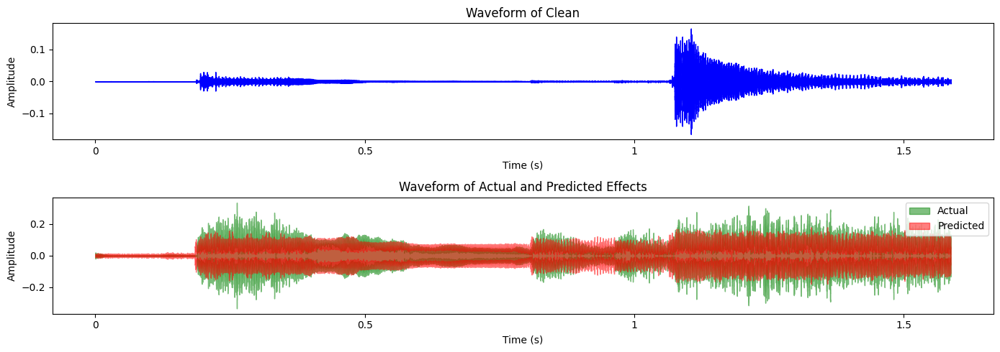

In [ ]:

# plt.figure(figsize=(14, 5))

# # Plot the clean waveform
# plt.subplot(2, 1, 1)
# librosa.display.waveshow(y_clean[645000:680000], sr=sr1, color='blue')
# plt.title('Waveform of Clean')
# plt.xlabel('Time (s)')
# plt.ylabel('Amplitude')

# # Plot the actual and predicted waveforms in the same subplot
# plt.subplot(2, 1, 2)
# librosa.display.waveshow(y_act[645000:680000], sr=sr1, color='green', alpha=0.5, label='Actual')
# librosa.display.waveshow(y_pred[645000:680000], sr=sr2, color='red', alpha=0.5, label='Predicted')
# plt.title('Waveform of Actual and Predicted Effects')
# plt.xlabel('Time (s)')
# plt.ylabel('Amplitude')
# plt.legend()

# plt.tight_layout()
# plt.show()
